# 19 Sep 23 - The Duffing Oscillator

We have developed a set of tools to investigate differential equations. You will now apply those skills to the [Duffing Oscillator](https://en.wikipedia.org/wiki/Duffing_equation). The Duffing Oscillator is a second order differential equation that is used to model a forced nonlinear spring. The equation is given by:

$$\frac{d^2x}{dt^2} + \delta \frac{dx}{dt} + \alpha x + \beta x^3 = \gamma \cos(\omega t)$$

And written in the form $\ddot{x} = f(x, \dot{x}, t)$, it is:

$$\ddot{x} = - \delta \dot{x} - \alpha x - \beta x^3 + \gamma \cos(\omega t)$$

where $x$ is the position of the oscillator, $\delta$ is a damping term, $\alpha$ is the stiffness of the spring, $\beta$ is the strength of the non-linear term, $\gamma$ is the amplitude of the driving force, and $\omega$ is the frequency of the driving force.

![Duffing Oscillator](https://upload.wikimedia.org/wikipedia/commons/f/fc/Duffing_oscillator_strange_attractor_with_color.gif)

*From [Wikipedia](https://commons.wikimedia.org/wiki/File:Duffing_oscillator_strange_attractor_with_color.gif)*

## Activity

This is a complicated oscillator with damping, forcing, and non-linearity. We will investigate the behavior of the oscillator for different values of the parameters, and you will need to bring all the tools we have used so far to bear on this problem. We will perform this work systematically, as way of helping you recognize the steps you can take to investigate any differential equation. *You are welcome to use any of the code that we developed or presented in class.*

### Organizing your analysis

The Duffing Oscillator has a lot of different elements and can become complicated very quickly. To help start our analysis let's consider three models with increasing complexity:

1. **Model 1** (no damping and no forcing) $\ddot{x} = - \alpha x - \beta x^3$
2. **Model 2** (no forcing) $\ddot{x} = - \delta \dot{x} - \alpha x - \beta x^3$
3. **Model 3** (full model) $\ddot{x} = - \delta \dot{x} - \alpha x - \beta x^3 + \gamma \cos(\omega t)$

**&#9989; Do this** 

### Tasks to complete

For each of these models, you should produce the following:

1. The fixed points (if they can be found and their linear stability)
2. A phase portrait of the system
3. A graph of x(t) for a given set of initial conditions
4. A graph of a trajectory in the phase portrait
5. An approximate solution to the differential equation for a limiting case

### Exploring your models

As you are developing your models, you should consider the following questions:

1. What kinds of motion seems possible for each model?
2. What are the limiting cases for each model? What solutions do they represent? Think about the physical meaning of the parameters.
3. What relationships exist between the parameters and the motion of the system? That is, what happens when you change the parameters?

In [1]:
## Imports to get started

import matplotlib.pyplot as plt
import numpy as np
from scipy.integrate import solve_ivp

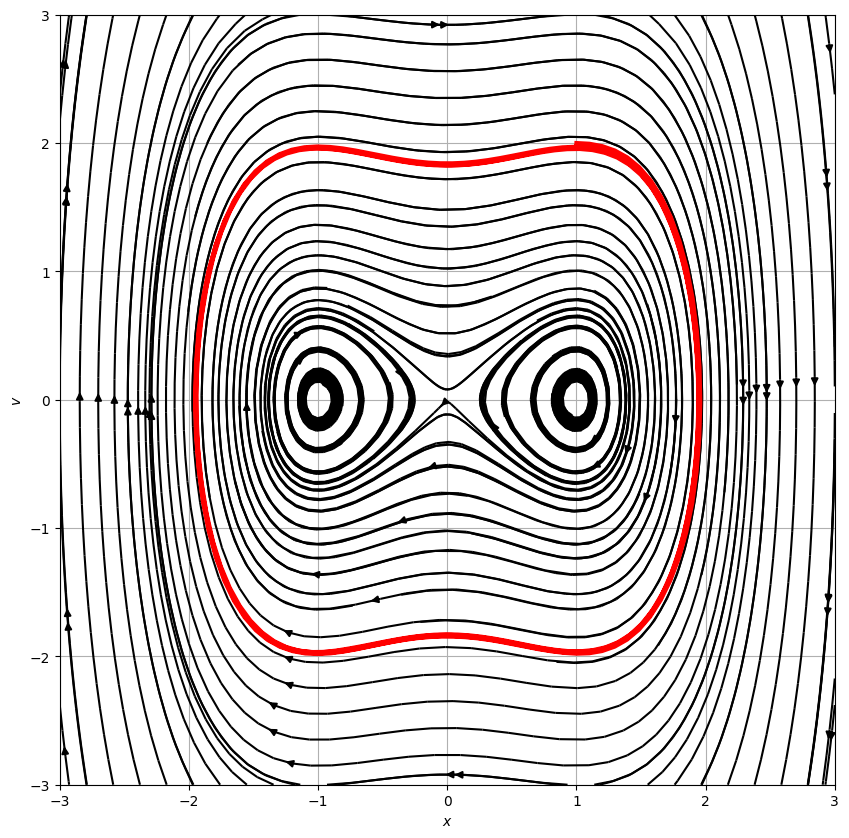

In [2]:
## Model 1

import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import solve_ivp

def VP_eqn(x, v):
    xdot, vdot = [v,x-x**3] ## CHANGE
    return xdot, vdot

def VP_phase(X, VX):
    xdot, vdot = np.zeros(X.shape), np.zeros(VX.shape)
    Xlim, Ylim = X.shape
    for i in range(Xlim):
        for j in range(Ylim):
            xloc = X[i, j]
            yloc = VX[i, j]
            xdot[i,j], vdot[i,j] = VP_eqn(xloc, yloc)
    return xdot, vdot

def VP_eqn_for_solve_ivp(t,curr_vals): # need to rephrase this to work with what solve_ivp expects
    x, v = curr_vals 
    xdot, vdot = VP_eqn(x,v)
    return xdot,vdot

# Numerical Integration
tmax = 20
dt = 0.05
tspan = (0,tmax)
t = np.arange(0,tmax,dt)
initial_condition = [1, 2] 
solved = solve_ivp(VP_eqn_for_solve_ivp,tspan,initial_condition,t_eval = t,method="RK45")


# Plotting stuff
N = 500
x = np.linspace(-3., 3., N)
v = np.linspace(-3., 3., N)
X, V = np.meshgrid(x, v)
xdot, vdot = VP_phase(X, V)
ax = plt.figure(figsize=(10,10))
Q = plt.streamplot(X, V, xdot, vdot, color='k',broken_streamlines = False)
plt.plot(solved.y[0],solved.y[1],lw = 3,c = 'red') # plot trajectory from solve_ivp
plt.grid()
plt.xlabel('$x$')
plt.ylabel('$v$')
plt.show()

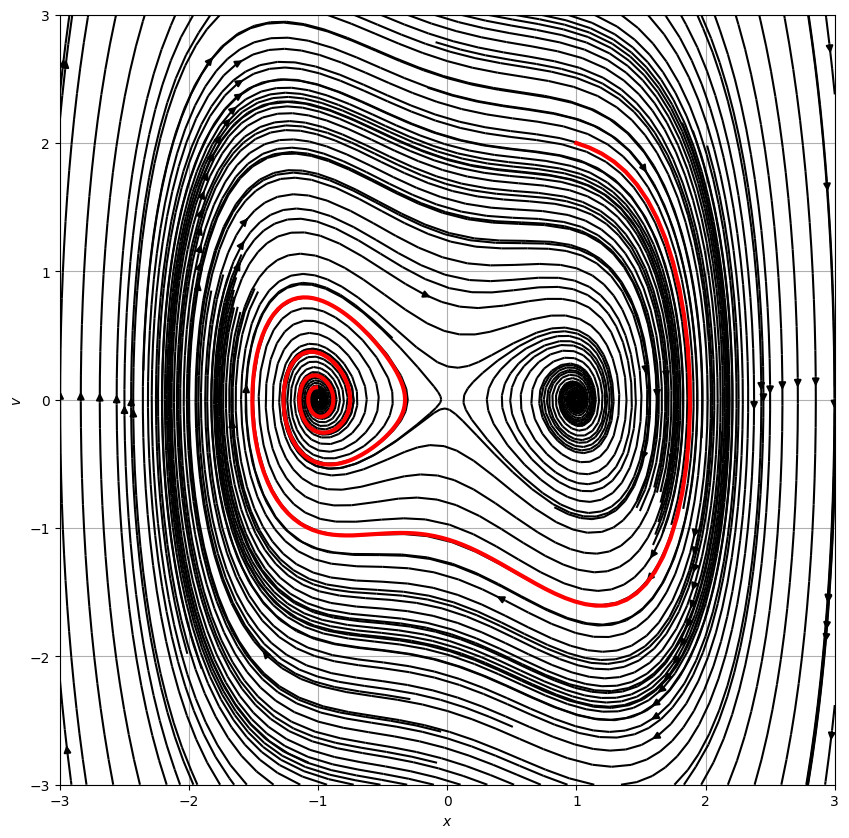

In [3]:
## Model 2

import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import solve_ivp

def VP_eqn(x, v):
    xdot, vdot = [v,-0.3*v+x-x**3] ## CHANGE
    return xdot, vdot

def VP_phase(X, VX):
    xdot, vdot = np.zeros(X.shape), np.zeros(VX.shape)
    Xlim, Ylim = X.shape
    for i in range(Xlim):
        for j in range(Ylim):
            xloc = X[i, j]
            yloc = VX[i, j]
            xdot[i,j], vdot[i,j] = VP_eqn(xloc, yloc)
    return xdot, vdot

def VP_eqn_for_solve_ivp(t,curr_vals): # need to rephrase this to work with what solve_ivp expects
    x, v = curr_vals 
    xdot, vdot = VP_eqn(x,v)
    return xdot,vdot

# Numerical Integration
tmax = 20
dt = 0.05
tspan = (0,tmax)
t = np.arange(0,tmax,dt)
initial_condition = [1, 2] 
solved = solve_ivp(VP_eqn_for_solve_ivp,tspan,initial_condition,t_eval = t,method="RK45")


# Plotting stuff
N = 40
x = np.linspace(-3., 3., N)
v = np.linspace(-3., 3., N)
X, V = np.meshgrid(x, v)
xdot, vdot = VP_phase(X, V)
ax = plt.figure(figsize=(10,10))
Q = plt.streamplot(X, V, xdot, vdot, color='k',broken_streamlines = False)
plt.plot(solved.y[0],solved.y[1],lw = 3,c = 'red') # plot trajectory from solve_ivp
plt.grid()
plt.xlabel('$x$')
plt.ylabel('$v$')
plt.show()

In [4]:
xdot.shape

(40, 40)

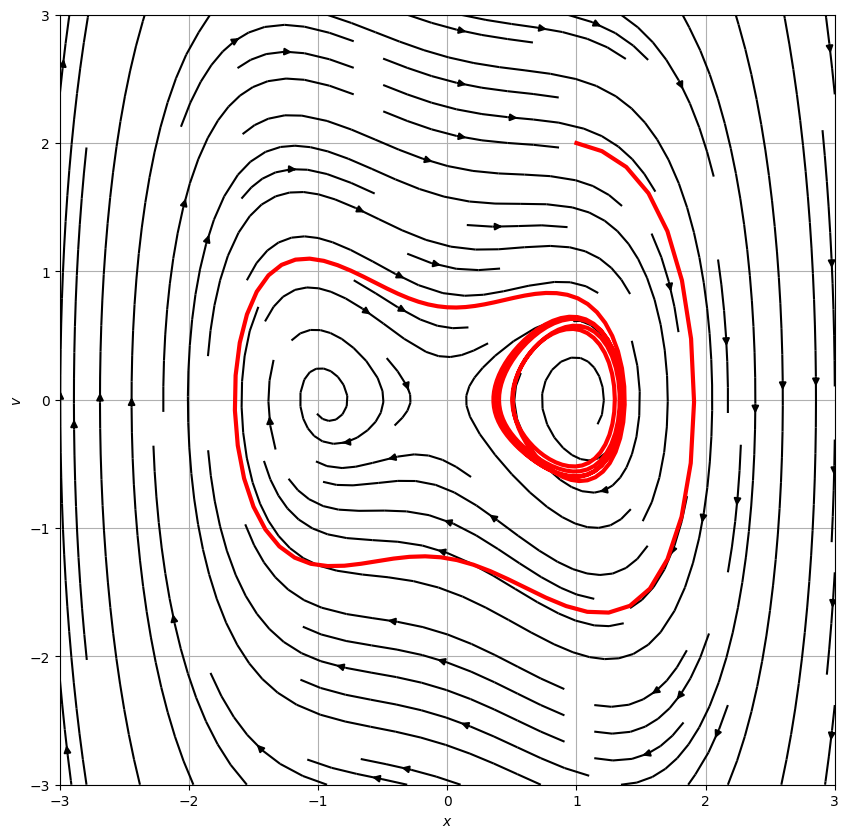

In [34]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import solve_ivp

def DO_eqn(x, v, t, gamma = 0.2):
    xdot, vdot = [v,-0.3*v+x-x**3+gamma*np.cos(1.2*t)] ## CHANGE
    return xdot, vdot

def DO_phase(X, VX, t):
    xdot, vdot = np.zeros(X.shape), np.zeros(VX.shape)
    Xlim, Ylim = X.shape
    for i in range(Xlim):
        for j in range(Ylim):
            xloc = X[i, j]
            yloc = VX[i, j]
            xdot[i,j], vdot[i,j] = DO_eqn(xloc, yloc, t)
    return xdot, vdot

def DO_eqn_for_solve_ivp(t,curr_vals, gamma=0.2): # need to rephrase this to work with what solve_ivp expects
    x, v = curr_vals 
    xdot, vdot = DO_eqn(x,v,t,gamma)
    return xdot,vdot

# Numerical Integration
tmax = 2*np.pi/1.2 *6
dt = 0.1
tspan = (0,tmax)
t = np.arange(0,tmax,dt)
initial_condition = [1, 2] 
solved = solve_ivp(DO_eqn_for_solve_ivp,tspan,initial_condition,t_eval = t, method="RK45")


# Plotting stuff
N = 40
x = np.linspace(-3., 3., N)
v = np.linspace(-3., 3., N)
X, V = np.meshgrid(x, v)

xdots = []
vdots = []
for time in t:
    xdot, vdot = DO_phase(X, V, time)
    xdots.append(xdot)
    vdots.append(vdot)


ax = plt.figure(figsize=(10,10))
Q = plt.streamplot(X, V, xdots[9], vdots[9], color='k',broken_streamlines = True)
plt.plot(solved.y[0],solved.y[1],lw = 3,c = 'red') # plot trajectory from solve_ivp
plt.grid()
plt.xlabel('$x$')
plt.ylabel('$v$')
plt.show()

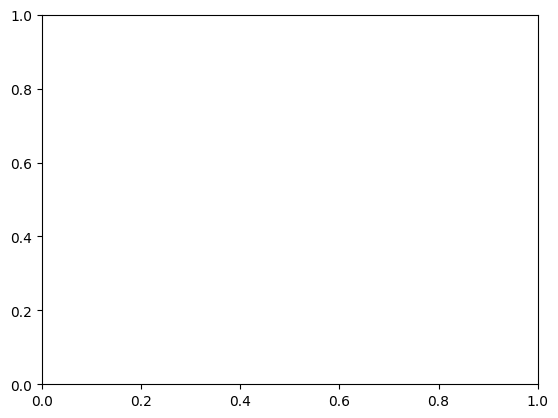

In [35]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
fig, ax = plt.subplots()
def init():
    ax.clear()
def update(frame):
    ax.clear()
    xdot, vdot = xdots[frame], vdots[frame]  # Assuming data is a list of sets
    ax.streamplot(X, V, xdot, vdot, color='k',broken_streamlines = False)
    ax.plot(solved.y[0][:frame],solved.y[1][:frame],lw = 3,c = 'red') # plot trajectory from solve_ivp
    ax.grid()
    #set x and y lims
    ax.set_xlim(-3,3)
    ax.set_ylim(-3,3)
    # ax.xlabel('$x$')
    # ax.ylabel('$v$')
    ax.set_title(f'Frame {frame + 1}')

num_frames = len(vdots)
ani = FuncAnimation(fig, update, frames=num_frames, init_func=init, blit=False, interval=100)




In [30]:
from IPython.display import HTML
HTML(ani.to_jshtml())

In [36]:
#export to gif
ani.save('duffing2.gif', writer='imagemagick', fps=60)

MovieWriter imagemagick unavailable; using Pillow instead.


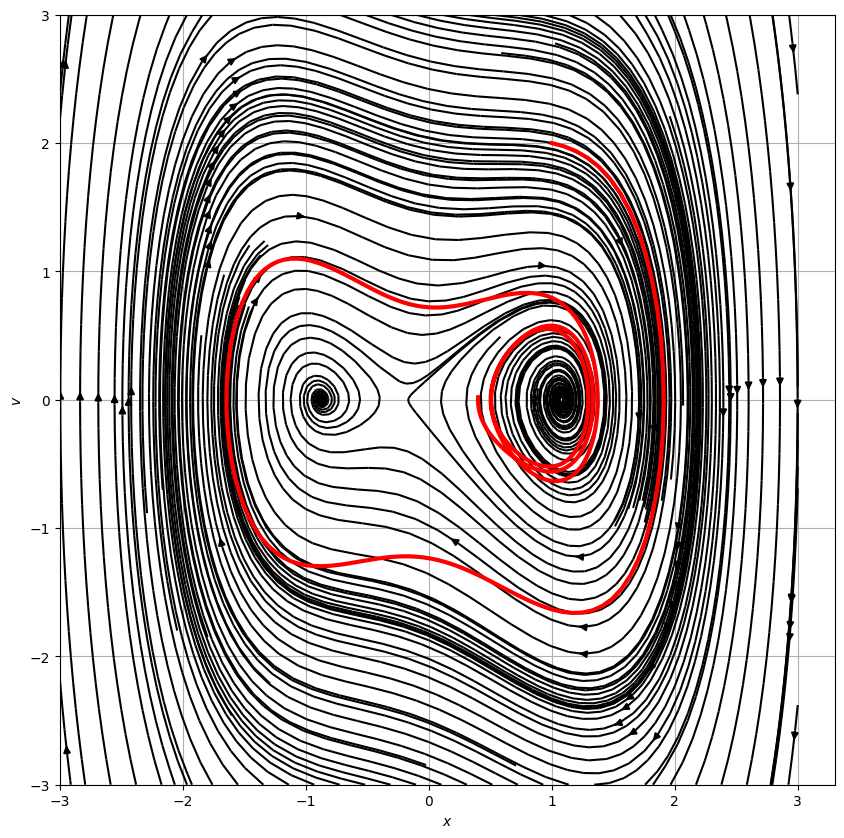

In [ ]:
# import numpy as np
# import matplotlib.pyplot as plt
# from scipy.integrate import solve_ivp

# def VP_eqn(x, v, t, gamma = 0.2):
#     xdot, vdot = [v,-0.3*v+x-x**3+gamma*np.cos(1.2*t)] ## CHANGE
#     return xdot, vdot

# def VP_phase(X, VX, gamma):
#     xdot, vdot = np.zeros(X.shape), np.zeros(VX.shape)
#     Xlim, Ylim = X.shape
#     for i in range(Xlim):
#         for j in range(Ylim):
#             xloc = X[i, j]
#             yloc = VX[i, j]
#             xdot[i,j], vdot[i,j] = VP_eqn(xloc, yloc,gamma)
#     return xdot, vdot

# def VP_eqn_for_solve_ivp(t,curr_vals, gamma=1): # need to rephrase this to work with what solve_ivp expects
#     x, v = curr_vals 
#     xdot, vdot = VP_eqn(x,v,t,gamma)
#     return xdot,vdot

# # Numerical Integration
# tmax = 20
# dt = 0.05
# tspan = (0,tmax)
# t = np.arange(0,tmax,dt)
# gamma = 0.20
# initial_condition = [1, 2] 
# solved = solve_ivp(VP_eqn_for_solve_ivp,tspan,initial_condition,t_eval = t, args = (gamma,),method="RK45")


# # Plotting stuff
# N = 40
# x = np.linspace(-3., 3., N)
# v = np.linspace(-3., 3., N)
# X, V = np.meshgrid(x, v)
# xdot, vdot = VP_phase(X, V,gamma)
# ax = plt.figure(figsize=(10,10))
# Q = plt.streamplot(X, V, xdot, vdot, color='k',broken_streamlines = False)
# plt.plot(solved.y[0],solved.y[1],lw = 3,c = 'red') # plot trajectory from solve_ivp
# plt.grid()
# plt.xlabel('$x$')
# plt.ylabel('$v$')
# plt.show()

## Routes to Chaos

One important route to chaotic behavior is through [period doubling](https://en.wikipedia.org/wiki/Period-doubling_bifurcation). It is not the only way for a system to become chaotic, but it is a characteristic way that a system will tend towards chaos. 

**&#9989; Do this** 

If your code is fully working, you can use known values of the parameters to investigate this behavior. For this part of the activity, you should use the full model and the following parameters:

| Parameter | Value |
|-----------|-------|
| $\alpha$  |  -1   |
| $\beta$   |  +1   |
| $\delta$  |  +0.3 |
| $\omega$  |  +1.2  |
| $\gamma$  |  +0.20 to +0.65 |

Here $\gamma$ is the only parameter that we will change. Produce phase plots of $x(t)$ and $x(\dot{x})$ for several choices of $\gamma$ with $x(0) = 1$ and $\dot{x}(0) = 0$.
